In [1]:
%load_ext autoreload
%autoreload 2

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import scanpy as sc 
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import os, sys 
sys.path.append('../../src')

/ihome/djishnu/alw399/.local/lib/python3.9/site-packages/louvain/__init__.py:54: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import get_distribution, DistributionNotFound


In [3]:
base_dir = '/ix/djishnu/shared/djishnu_kor11/'

adata = sc.read_h5ad(base_dir + 'training_data_2025/snrna_human_tonsil.h5ad')
adata

AnnData object with n_obs × n_vars = 5778 × 3333
    obs: 'cell_type', 'author_cell_type', 'cell_type_int', 'banksy_celltypes'
    uns: 'cell_thresholds', 'cell_type_int_colors', 'received_ligands', 'received_ligands_tfl'
    obsm: 'spatial', 'spatial_unscaled'
    layers: 'imputed_count', 'normalized_count'

In [4]:
del adata.uns['received_ligands']
del adata.uns['received_ligands_tfl']

# Remove pre-processing from COMMOT
adata.uns['cell_thresholds'] = pd.DataFrame(
    index=adata.obs.index, 
    columns=adata.var_names).fillna(1)

adata

/tmp/ipykernel_21557/3928045929.py:5: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  adata.uns['cell_thresholds'] = pd.DataFrame(


AnnData object with n_obs × n_vars = 5778 × 3333
    obs: 'cell_type', 'author_cell_type', 'cell_type_int', 'banksy_celltypes'
    uns: 'cell_thresholds', 'cell_type_int_colors'
    obsm: 'spatial', 'spatial_unscaled'
    layers: 'imputed_count', 'normalized_count'

In [5]:
sp_maps = pd.read_parquet('/ix/djishnu/shared/djishnu_kor11/scGPT_outputs/tonsil_embeddings.parquet')
sp_maps = sp_maps.reindex(adata.obs.index, axis=0).values

adata.obsm['scGPT'] = sp_maps
adata.obsm['scGPT'].shape

(5778, 512)

### Genome screen

In [6]:
import sys 
sys.path.append('../../../src')
from spaceoracle.plotting.cartography import Cartography
from spaceoracle.gene_factory import GeneFactory


2025-06-07 23:20:51.175670: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /ihome/crc/install/gcc-12.2.0/postgresql/15.2/lib:/ihome/crc/install/gcc-12.2.0/imagemagick/6.9.12/lib:/ihome/crc/install/gcc-12.2.0/geos/3.9.4/lib:/ihome/crc/install/gcc-12.2.0/zstd/zstd-1.5.5/lib:/ihome/crc/install/gcc-12.2.0/unixodbc/2.3.11/lib:/ihome/crc/install/sodium/1.0.18/lib:/ihome/crc/install/gcc-12.2.0/r/4.4.0/lib64/R/lib:/ihome/crc/install/gcc-12.2.0/openmpi/4.1.5/lib:/ihome/crc/install/gcc-12.2.0/fftw/3.3.10/lib:/ihome/crc/install/gcc-12.2.0/glpk/5.0/lib:/ihome/crc/install/gcc-12.2.0/proj/4.9.3/lib:/ihome/crc/install/gcc-12.2.0/gdal/2.4.4/lib:/ihome/crc/install/gcc-12.2.0/netcdf/4.8.1/lib:/ihome/crc/install/gcc-12.2.0/hdf5/1.14.0/lib:/ihome/crc/install/gcc-12.2.0/jags/4.3.2/lib:/ihome/crc/install/gcc-12.2.0/gsl/2.7.1/lib:/ihome/c

In [7]:
gf = GeneFactory.from_json(
    adata, 
    '/ix/djishnu/shared/djishnu_kor11/scGPT_runs/tonsil/run_params.json', 
)

gf.load_betas(float16=True, obs_names=None)

In [21]:
genes = ['IL21', 'FOXO1', 'IL6ST', 'GZMA', 'CXCR4', 'CXCL12', 'CCR2', 'IL7R',
         'GATA3', 'PAX5', 'FOXP3', 'BCL6', 'TBX21', 'PRDM1']

# genes = [
#        'IL2', 'IL4', 'IL6ST', 'GZMA', 'IL2RA',
#        'CXCR4', 'CCR4', 'IL4RA', 'GATA3', 'GATA2',
#        'PAX5', 'STAT4', 'FOXP3', 'BCL6', 'CCL20',
#        'CCR7', 'IL21R', 'IL21', 'CCL5', 
#        'AICDA', 'BACH2', 'BATF', 'BCL2', 'BCL2A1', 'BCL6', 'BMS1P14',
#        'CCL19', 'CCL21', 'CCL5', 'CCR4', 'CCR6', 'CCR7', 'CD19', 'CD274',
#        'CD28', 'CD40', 'CD40LG', 'CD80', 'CD83', 'CD86', 'CR2', 'CXCL12',
#        'CXCL13', 'CXCL14', 'CXCR4', 'CXCR5', 'EBI3', 'EGR1', 'EGR2',
#        'EGR3', 'EPCAM', 'FOXO1', 'FOXP3', 'GATA3', 'ICAM1', 'ICAM2',
#        'ICAM3', 'ICOS', 'ICOSLG', 'ID2', 'IL4', 'IL6', 'IL6R', 'IL6ST',
#        'IRF4', 'IRF8', 'ITGA5', 'ITGAM', 'ITGB1', 'ITGB2', 'LGALS9', 'IL7', 'IL7R',
#        'LMO2', 'MICOS10', 'MICOS13', 'NFKB1', 'NFKB2', 'NFKBIA', 'NFKBIB',
#        'NFKBID', 'NFKBIE', 'NFKBIL1', 'NFKBIZ', 'PAX5', 'PDCD1', 'PDCD11',
#        'PDCD1LG2', 'PRDM1', 'S1PR1', 'S1PR2', 'S1PR3', 'S1PR4', 'SATB1',
#        'SDF2', 'SDF2L1', 'SDF4', 'STAT1', 'STAT3', 'STAT4', 'STAT6',
#        'TBX21', 'TICAM1', 'TICAM2', 'TRAF3', 'VCAM1']

genes = [g for g in np.unique(genes) if g in adata.var_names]
len(genes)

14

In [10]:
max_expr = adata[:, 'IL21'].layers['imputed_count'].max()
max_expr.item()

0.9892565953798496

In [13]:
gex_out = gf.perturb(
    target='IL21', 
    n_propagation=4,
    gene_expr=max_expr.item()
)

gex_out.to_parquet(
    '/ix/djishnu/shared/djishnu_kor11/genome_screens/human_tonsil_scGPT/IL21_4n_maxx.parquet'
)

In [25]:
gf.genome_screen(
    save_to=base_dir + '/genome_screens/human_tonsil_scGPT',
    n_propagation=4,
    priority_genes=genes
)

### Compare betas

In [7]:
goi = 'BCL6'

cnn_dir = '/ix/djishnu/shared/djishnu_kor11/lasso_runs/human_tonsil/'
cnn_beta = pd.read_parquet(cnn_dir + f'{goi}_betadata.parquet')

cnn_beta.head(3)

,beta0,beta_AR,beta_ARNTL,beta_BATF,beta_BHLHE40,beta_BHLHE41,beta_CREB3L2,beta_DBP,beta_EBF1,beta_EGR1,...,beta_IL21#SP4,beta_IL26#SP4,beta_IFNG#STAT1,beta_IL21#STAT1,beta_IL21#STAT3,beta_IL10#STAT3,beta_IL26#ZNF219,beta_CCL28#ZNF740,beta_CCL19#ZNF740,beta_IL26#ZNF740
NAME,,,,,,,,,,,,,,,,,,,,,
AAACCCAAGCGCCTTG-1,0.164711,0.000000,0.041056,-0.003898,0.170445,-0.074525,0.018012,-0.141717,-0.006988,-0.159196,...,0.003271,0.000733,0.000132,0.002042,0.010679,0.000323,-0.000001,-0.000177,-0.000139,-0.000003
AAACCCAAGTGGACGT-1,0.108571,0.000000,0.056297,0.321343,0.160398,-0.032009,-0.002460,-0.034334,0.031808,0.127908,...,0.000158,-0.002592,-0.001169,-0.000357,0.001309,0.000002,-0.000337,0.000087,-0.000161,-0.001738
AAACCCACAGAAGTGC-1,0.152617,0.895943,0.141407,-0.701189,0.746719,-0.575875,0.167658,-0.149750,0.122716,0.320530,...,0.040215,0.012551,0.002029,0.047163,0.052559,-0.001426,0.000463,-0.000676,-0.000170,0.000325


In [8]:
gpt_dir = '/ix/djishnu/shared/djishnu_kor11/scGPT_runs/tonsil/'
gpt_beta = pd.read_parquet(gpt_dir + f'{goi}_betadata.parquet')

gpt_beta = gpt_beta.loc[cnn_beta.index]
gpt_beta.head(3)

,beta0,beta_FOSL2,beta_NAMPT,beta_NIBAN1,beta_NABP1,beta_BHLHE40,beta_UGCG,beta_STAT3,beta_NAMPT#NIBAN1,beta_NAMPT#NABP1,beta_NAMPT#UGCG,beta_NAMPT#BHLHE40,beta_NAMPT#FOSL2,beta_NAMPT#STAT3
NAME,,,,,,,,,,,,,,
AAACCCAAGCGCCTTG-1,0.007993,0.003650,0.040648,0.071632,0.001751,0.012937,1.071411,0.003173,1.409200,1.459491,1.498207,1.485667,1.477418,1.495980
AAACCCAAGTGGACGT-1,0.001542,0.001911,0.364894,0.759534,0.000778,0.004040,0.236035,0.001063,1.472257,0.048946,1.499197,0.084983,1.478306,1.496794
AAACCCACAGAAGTGC-1,0.001621,0.001938,0.324561,0.690061,0.000829,0.004258,0.395367,0.001161,1.468317,0.050329,1.499098,0.087100,1.473222,1.496550


In [9]:
bois = set(gpt_beta.columns) & set(cnn_beta.columns)
bois

{'beta0', 'beta_BHLHE40', 'beta_FOSL2', 'beta_STAT3'}

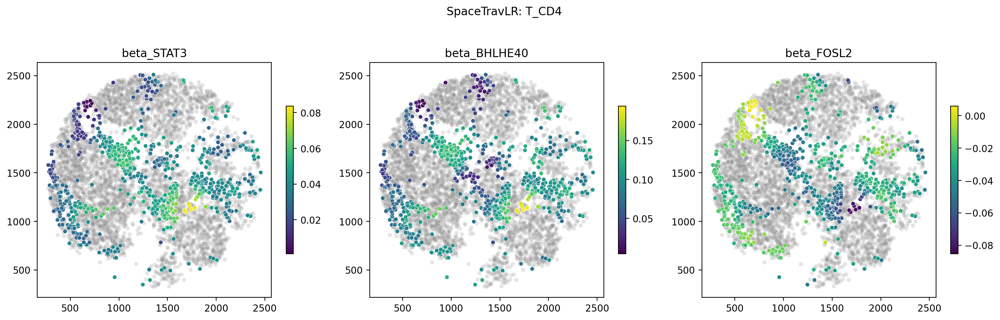

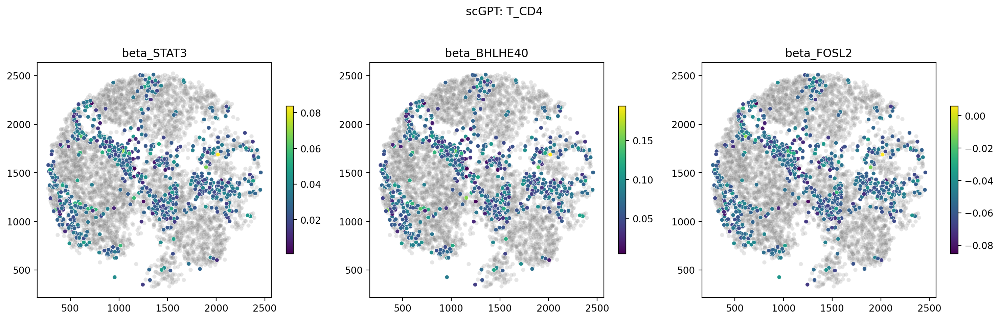

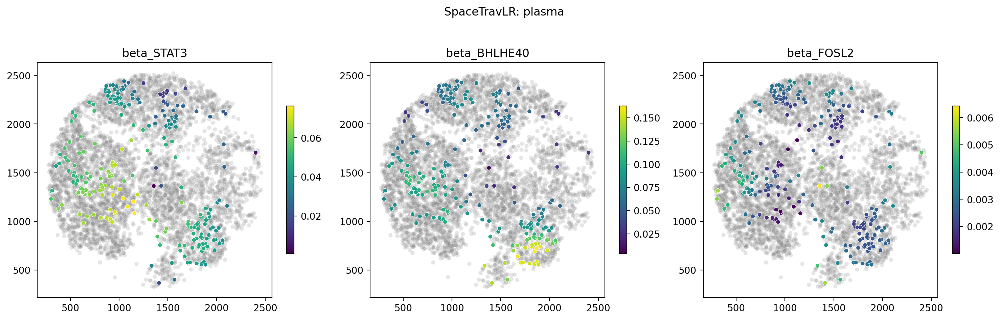

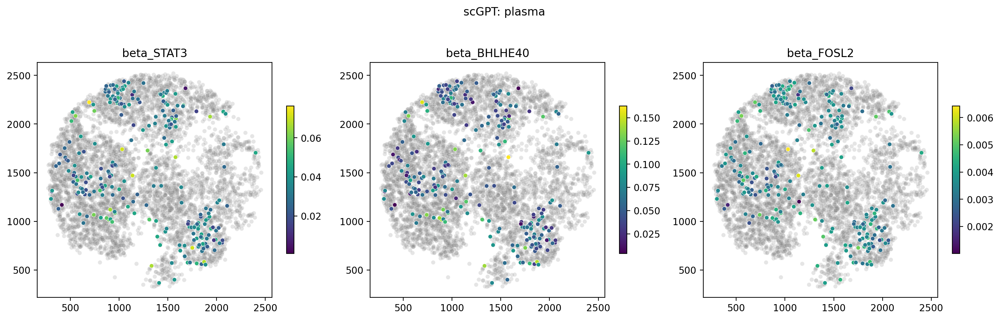

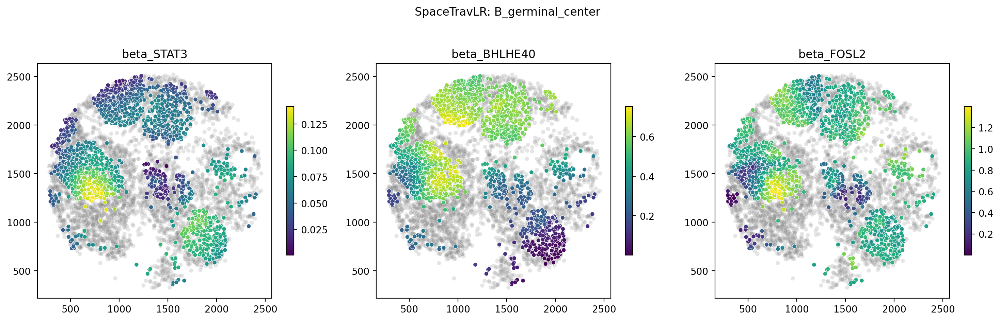

...

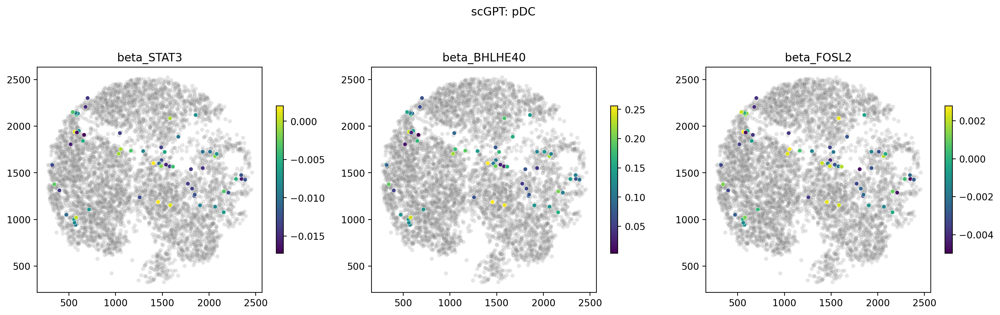

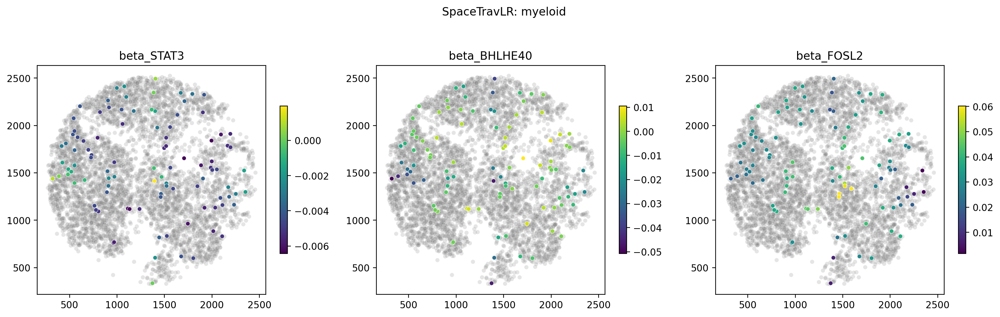

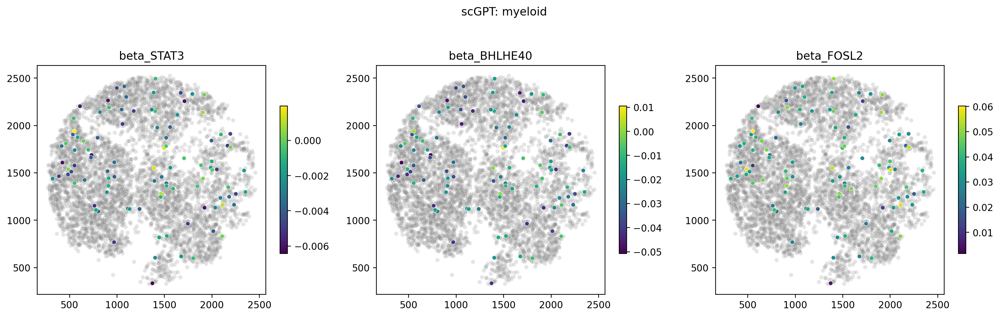

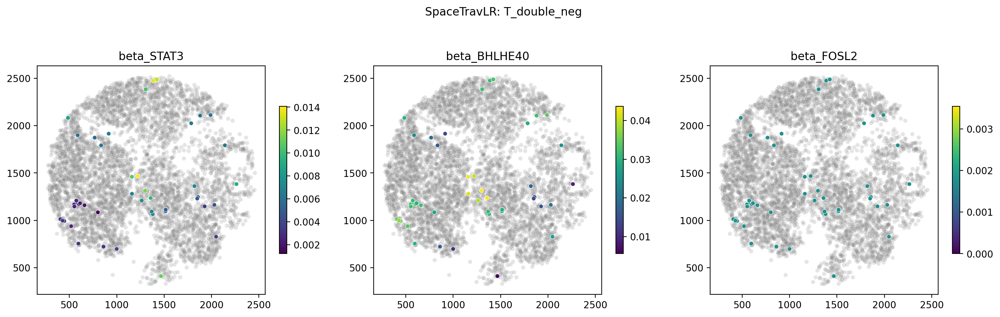

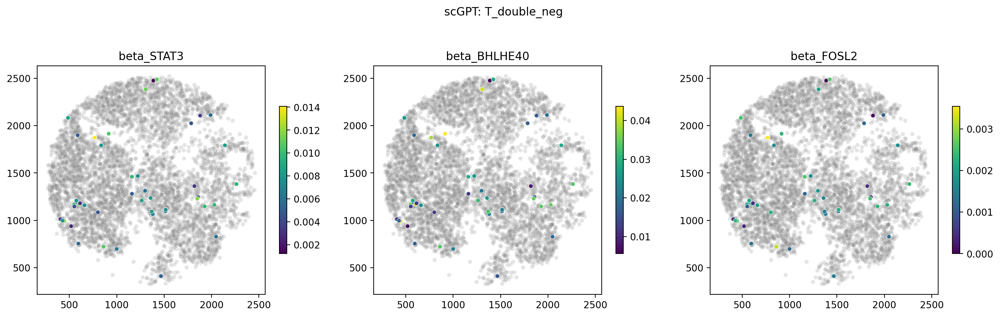

In [10]:
# Plot SpaceTravLR results

def plot_betas_spatial(
    adata, 
    cnn_beta, 
    gpt_beta, 
    bois, 
    celltype=None,
    figsize=(5*len(bois), 5),
):
    
    if celltype is not None:
        celltype_mask = adata.obs['cell_type'] == celltype
    else:
        celltype_mask = np.ones(len(adata), dtype=bool)

    fig, axes = plt.subplots(1, len(bois), figsize=(5*len(bois), 5))
    for i, col in enumerate(bois):

        scatter = sns.scatterplot(
            data=pd.DataFrame({
                'x': adata.obsm['spatial'][:, 0],
                'y': adata.obsm['spatial'][:, 1],
            }),
            x='x', y='y',
            color='gray',
            alpha=0.2,
            ax=axes[i],
            s=20,
            legend=False
        )
        
         # Get min/max values for this specific column
        vmin = min(cnn_beta.loc[celltype_mask, col].min(), gpt_beta.loc[celltype_mask, col].min())
        vmax = max(cnn_beta.loc[celltype_mask, col].max(), gpt_beta.loc[celltype_mask, col].max())
        
        # Plot using seaborn scatterplot
        scatter = sns.scatterplot(
            data=pd.DataFrame({
                'x': adata[celltype_mask].obsm['spatial'][:, 0],
                'y': adata[celltype_mask].obsm['spatial'][:, 1],
                'value': cnn_beta.loc[celltype_mask, col]
            }),
            x='x', y='y',
            hue='value',
            palette='viridis',
            ax=axes[i],
            s=20,
            legend=False
        )
        axes[i].set_title(f'{col}')
        axes[i].set_aspect('equal')
        axes[i].set_xlabel('')
        axes[i].set_ylabel('')
        
        # Add colorbar
        norm = plt.Normalize(vmin, vmax)
        sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
        sm.set_array([])
        plt.colorbar(sm, ax=axes[i], shrink=0.5)
    
    plt.suptitle(f'SpaceTravLR: {celltype}')
    plt.tight_layout()
    plt.show()

    # Plot scGPT results
    fig, axes = plt.subplots(1, len(bois), figsize=(5*len(bois), 5))
    for i, col in enumerate(bois):

        scatter = sns.scatterplot(
            data=pd.DataFrame({
                'x': adata.obsm['spatial'][:, 0],
                'y': adata.obsm['spatial'][:, 1],
            }),
            x='x', y='y',
            color='gray',
            alpha=0.2,
            ax=axes[i],
            s=20,
            legend=False
        )

        # Get min/max values for this specific column
        vmin = min(cnn_beta.loc[celltype_mask, col].min(), gpt_beta.loc[celltype_mask, col].min())
        vmax = max(cnn_beta.loc[celltype_mask, col].max(), gpt_beta.loc[celltype_mask, col].max())
        
        # Plot using seaborn scatterplot
        scatter = sns.scatterplot(
            data=pd.DataFrame({
                'x': adata[celltype_mask].obsm['spatial'][:, 0],
                'y': adata[celltype_mask].obsm['spatial'][:, 1],
                'value': gpt_beta.loc[celltype_mask, col]
            }),
            x='x', y='y',
            hue='value',
            palette='viridis',
            ax=axes[i],
            s=20,
            legend=False
        )
        axes[i].set_title(f'{col}')
        axes[i].set_aspect('equal')
        axes[i].set_xlabel('')
        axes[i].set_ylabel('')
        
        # Add colorbar
        norm = plt.Normalize(vmin, vmax)
        sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
        sm.set_array([])
        plt.colorbar(sm, ax=axes[i], shrink=0.5)
    
    plt.suptitle(f'scGPT: {celltype}')
    plt.tight_layout()
    plt.show()

for ct in adata.obs['cell_type'].unique():
    plot_betas_spatial(
        adata, 
        cnn_beta, 
        gpt_beta, 
        list(bois - {'beta0'}), 
        celltype=ct)